In [ ]:
!pip install spams
!pip install staintools

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 1.7 MB/s eta 0:00:00
  Installing build dependencies ... - \ | / - \ | / - \ | / done
  Getting requirements to build wheel ... - done
  Preparing metadata (pyproject.toml) ... - done
  Created wheel for spams: filename=spams-2.6.5.4-cp37-cp37m-linux_x86_64.whl size=4693806 sha256=e791c76ed81339c0e9d1a7f6cec5e4cedc9fcece4b15df76075388f381781161
  Stored in directory: /root/.cache/pip/wheels/5e/92/17/e718e0e26bfcdd7e81afcf874ac2bc599dd7dd7f3ad78f9d76
Successfully built spams
  Preparing metadata (setup.py) ... - done
  Created wheel for staintools: filename=staintools-2.1.2-py3-none-any.whl size=14075 sha256=93cf6ff319ecba66d4ace9e4141e9f19495c3c0d790bff7b44c1ae814f29fe6f
  Stored in directory: /root/.cache/pip/wheels/9b/ed/74/9d36d40854e911d8e2d2d28d7b67e37e9f176f913ecf34f813
Successfully built staintools


In [ ]:
import pathlib
import json
import numpy as np
import pandas as pd
import cv2
import tifffile
import matplotlib.pyplot as plt
import staintools

In [ ]:
INTERNAL_DATASET = pathlib.Path('../input/hubmap-organ-segmentation')

df_train = pd.read_csv(INTERNAL_DATASET / 'train.csv')
df_test = pd.read_csv(INTERNAL_DATASET / 'test.csv')

train_images = 'train_images/'
train_annotations = 'train_annotations/'
test_images = 'test_images/'

df_train['image_filename'] = df_train['id'].apply(lambda x:  str(INTERNAL_DATASET) + '/' + train_images + str(x) + '.tiff')
df_train['polygon_filename'] = df_train['id'].apply(lambda x:  str(INTERNAL_DATASET) + '/' + train_annotations + str(x) + '.json')
df_test['image_filename'] = df_test['id'].apply(lambda x:  str(INTERNAL_DATASET) + '/' + test_images + str(x) + '.tiff')
df_test['age'] = np.nan
df_test['sex'] = np.nan

print(f'Training Set Shape: {df_train.shape} - Memory Usage: {df_train.memory_usage().sum() / 1024 ** 2:.2f} MB')
print(f'Test Set Shape: {df_test.shape} - Memory Usage: {df_test.memory_usage().sum() / 1024 ** 2:.2f} MB')

Training Set Shape: (351, 12) - Memory Usage: 0.03 MB
Test Set Shape: (1, 10) - Memory Usage: 0.00 MB


Pixel sizes and tissue thicknesses are provided in [data](https://www.kaggle.com/competitions/hubmap-organ-segmentation/data) tab. Pixel size is 0.4 μm and tissue thickness is 4 μm for every organ type for HPA images. Pixel sizes and tissue thicknesses are different among organs for HuBMAP images. Pixel sizes are 0.5 µm for kidney, 0.2290 µm for large intestine, 0.7562 µm for lung, 0.4945 µm for spleen, and 6.263 µm for prostate. Tissue slice thicknesses are 10 µm for kidney, 8 µm for large intestine, 4 µm for spleen, 5 µm for lung, and 5 µm for prostate.

In [ ]:
imaging_measurements = {
    'hpa': {
        'pixel_size': {
            'kidney': 0.4,
            'prostate': 0.4,
            'largeintestine': 0.4,
            'spleen': 0.4,
            'lung': 0.4
        },
        'tissue_thickness': {
            'kidney': 4,
            'prostate': 4,
            'largeintestine': 4,
            'spleen': 4,
            'lung': 4
        }
    },
    'hubmap': {
        'pixel_size': {
            'kidney': 0.5,
            'prostate': 6.263,
            'largeintestine': 0.229,
            'spleen': 0.4945,
            'lung': 0.7562
        },
        'tissue_thickness': {
        'kidney': 10,
            'prostate': 5,
            'largeintestine': 8,
            'spleen': 4,
            'lung': 5
        }
    }
}

print(json.dumps(imaging_measurements, indent=2))

{
  "hpa": {
    "pixel_size": {
      "kidney": 0.4,
      "prostate": 0.4,
      "largeintestine": 0.4,
      "spleen": 0.4,
      "lung": 0.4
    },
    "tissue_thickness": {
      "kidney": 4,
      "prostate": 4,
      "largeintestine": 4,
      "spleen": 4,
      "lung": 4
    }
  },
  "hubmap": {
    "pixel_size": {
      "kidney": 0.5,
      "prostate": 6.263,
      "largeintestine": 0.229,
      "spleen": 0.4945,
      "lung": 0.7562
    },
    "tissue_thickness": {
      "kidney": 10,
      "prostate": 5,
      "largeintestine": 8,
      "spleen": 4,
      "lung": 5
    }
  }
}


In [ ]:
np.random.seed(42)
df_sample = df_train.groupby('organ').sample(1).reset_index(drop=True)
df_sample

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex,image_filename,polygon_filename
0,27879,kidney,HPA,3000,3000,0.4,4,1429275 9 1432266 26 1435260 36 1438240 59 144...,70.0,Male,../input/hubmap-organ-segmentation/train_image...,../input/hubmap-organ-segmentation/train_annot...
1,23094,largeintestine,HPA,3000,3000,0.4,4,5252280 9 5252296 17 5255263 55 5258261 59 526...,55.0,Female,../input/hubmap-organ-segmentation/train_image...,../input/hubmap-organ-segmentation/train_annot...
2,27232,lung,HPA,3000,3000,0.4,4,1754231 15 1757231 16 1760229 18 1763227 21 17...,43.0,Female,../input/hubmap-organ-segmentation/train_image...,../input/hubmap-organ-segmentation/train_annot...
3,2174,prostate,HPA,3000,3000,0.4,4,3131713 7 3134708 14 3137706 18 3140705 19 314...,48.0,Male,../input/hubmap-organ-segmentation/train_image...,../input/hubmap-organ-segmentation/train_annot...
4,25472,spleen,HPA,3000,3000,0.4,4,751904 15 754888 32 757880 45 760878 53 763876...,74.0,Female,../input/hubmap-organ-segmentation/train_image...,../input/hubmap-organ-segmentation/train_annot...


### Pixel Size

Adapting the pixel size is easier. Relative scale factor can be calculated by `domain_pixel_size / target_pixel_size`. For example, HPA prostate images have 0.4 μm and HuBMAP prostate images have 6.263 μm pixel size. `0.4 / 6.263` is `0.063` which is approximately 1/16, so HPA prostate images are 16x larger than HuBMAP prostate images. Downsampling and upsampling HPA prostate images by that scale could yield similar images to HuBMAP prostate images in terms of pixel size. This is shared by [@hengck23](https://www.kaggle.com/hengck23) in [this](https://www.kaggle.com/competitions/hubmap-organ-segmentation/discussion/332941#1874042) post.

### Tissue Thickness

Adapting the tissue thickness is more experimental. From the figures below (Chilipala, 2020, fig. 3, 10), it can be seen that stain intensity increases when tissue is thicker. It makes a lot of sense because as the tissue gets thicker, less light can go through it.

Increase of stain intesity is very strong in H&E stained images for both hematoxylin and eosin for every organ. However, it varies for IHC methods. As same of the HuBMAP images are H&E stained, same transformation can be applied to them. 

![tissue_thickness1](https://i.ibb.co/jzx3p9B/Screenshot-from-2022-08-07-20-10-26.png)

![tissue_thickness2](https://i.ibb.co/G9D9Bqm/Screenshot-from-2022-08-07-20-12-47.png)

I used this function to adapt pixel sizes and tissue thicknesses. The function is very simple at this point. 

For tissue thickness, it multiplies saturation channel with `1 + alpha * (target_tissue_thickness - domain_tissue_thickness)` and multiplies value channel with `1 - alpha * (target_tissue_thickness - domain_tissue_thickness)`. It always upscales saturation and downscales value because all of HuBMAP image tissues are thicker than HPA image tissues, thus they might have more stain intensity. I added another multiplier alpha and set it to 0.15 which worked good on sample images but it might break on different images.

For pixel size, it downsamples and upsamples the same image by a factor of `domain_pixel_size / target_pixel_size`.

Luminosity is standardized using `staintools` package in order reduce artifacts on the background.

In [ ]:
def augment_image(image, domain_pixel_size, target_pixel_size, domain_tissue_thickness, target_tissue_thickness, alpha=0.15):
    
    
    # Augment tissue thickness
    tissue_thickness_scale_factor = target_tissue_thickness - domain_tissue_thickness
    image_hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV).astype(np.float32)
    image_hsv[:, :, 1] *= (1 + (alpha * tissue_thickness_scale_factor))
    image_hsv[:, :, 2] *= (1 - (alpha * tissue_thickness_scale_factor))
    image_hsv = image_hsv.astype(np.uint8)
    image_scaled = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)
    
    # Standardize luminosity
    image_scaled = staintools.LuminosityStandardizer.standardize(image_scaled)

    # Augment pixel size
    pixel_size_scale_factor = domain_pixel_size / target_pixel_size
    image_resized = cv2.resize(
        image_scaled,
        dsize=None,
        fx=pixel_size_scale_factor,
        fy=pixel_size_scale_factor,
        interpolation=cv2.INTER_CUBIC
    )
    image_resized = cv2.resize(
        image_resized,
        dsize=(
            image.shape[1],
            image.shape[0]
        ),
        interpolation=cv2.INTER_CUBIC
    )
    
    # Standardize luminosity
    image = staintools.LuminosityStandardizer.standardize(image)
    image_augmented = staintools.LuminosityStandardizer.standardize(image_resized)
    
    return image, image_augmented


In [ ]:
def visualize_augmentation(image, image_augmented, metadata, path=None):

    fig, axes = plt.subplots(figsize=(36, 20), ncols=2)
    
    axes[0].imshow(image)
    axes[1].imshow(image_augmented)

    for i in range(2):
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')
        axes[i].tick_params(axis='x', labelsize=15, pad=10)
        axes[i].tick_params(axis='y', labelsize=15, pad=10)

    axes[0].set_title(f'Raw Image\nMean: {np.mean(image):.4f} - Std: {np.std(image):.4f} - Min: {np.min(image)} - Max: {np.max(image)}', size=25, pad=15)
    axes[1].set_title(f'Augmented Image\nMean: {np.mean(image_augmented):.4f} - Std: {np.std(image_augmented):.4f} - Min: {np.min(image_augmented)} - Max: {np.max(image_augmented)}', size=25, pad=15)

    fig.suptitle(
        f'''
        Image ID {metadata["id"]} - {metadata["organ"]} - {metadata["data_source"]} - {metadata["age"]} - {metadata["sex"]}
        Raw Image Shape: {metadata["img_height"]}x{metadata["img_width"]} - Pixel Size: {metadata["pixel_size"]}µm - Tissue Thickness: {metadata["tissue_thickness"]}µm
        Augmented Image Shape: {metadata["img_height"]}x{metadata["img_width"]} - Pixel Size: {imaging_measurements["hubmap"]["pixel_size"][metadata["organ"]]}µm - Tissue Thickness: {imaging_measurements["hubmap"]["tissue_thickness"][metadata["organ"]]}µm
        ''',
        fontsize=50,
        y=1.05
    )

    if path is None:
        plt.show()
    else:
        plt.savefig(path)
        plt.close(fig)

Most intense transformations are kidney and large intestine images in terms of tissue thickness and prostate image in terms of pixel size. Other images aren't drastically transformed because their imaging measurements were close to each other. 

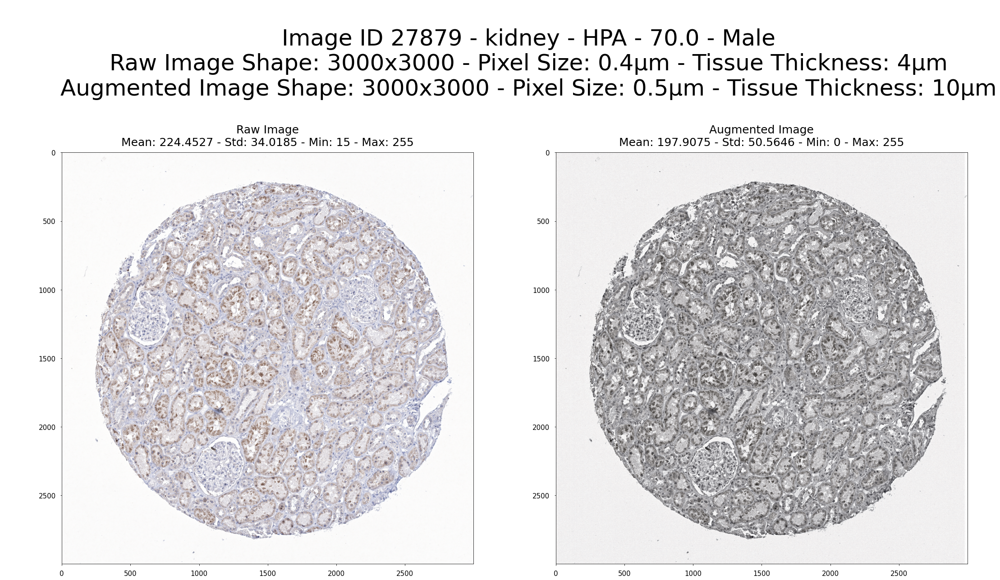

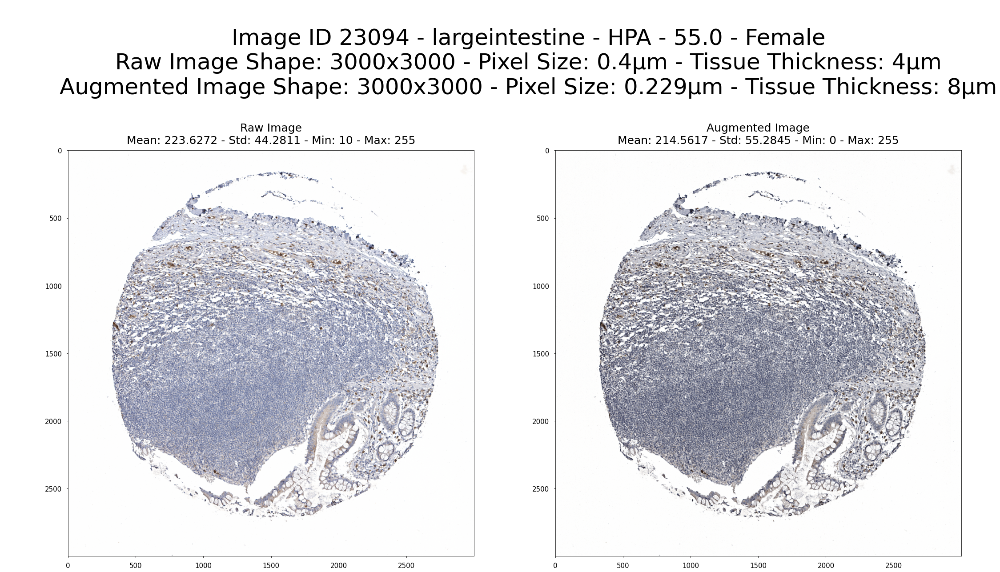

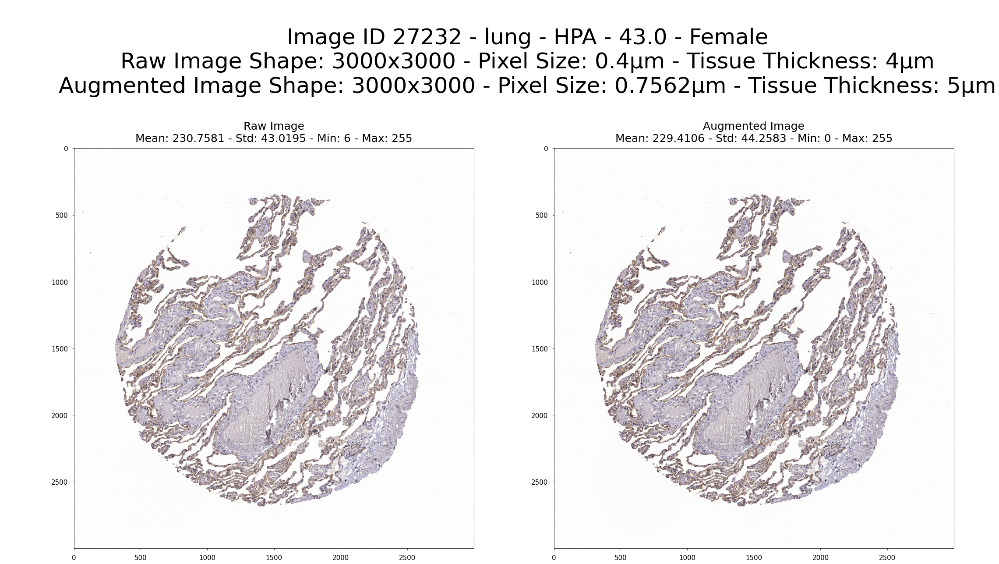

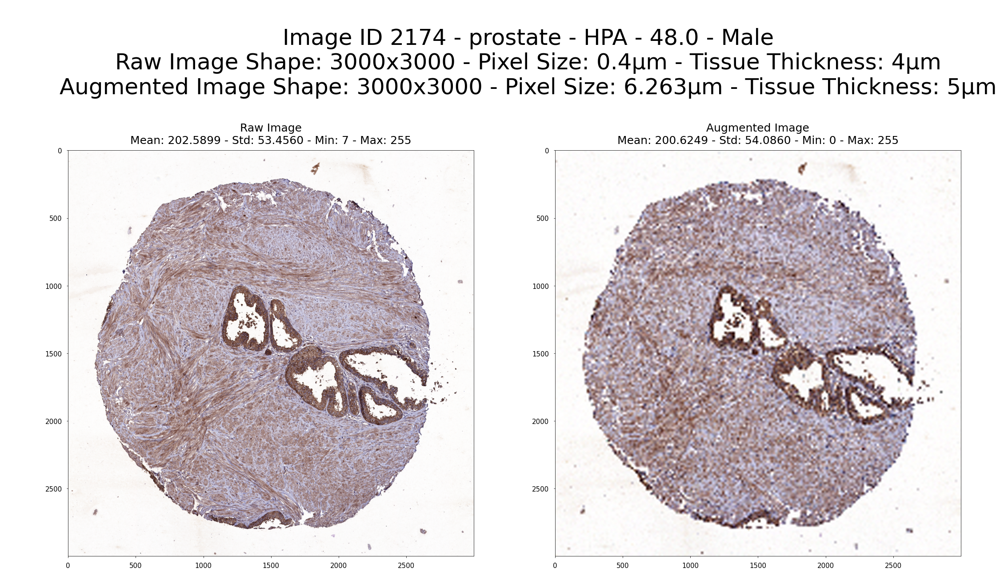

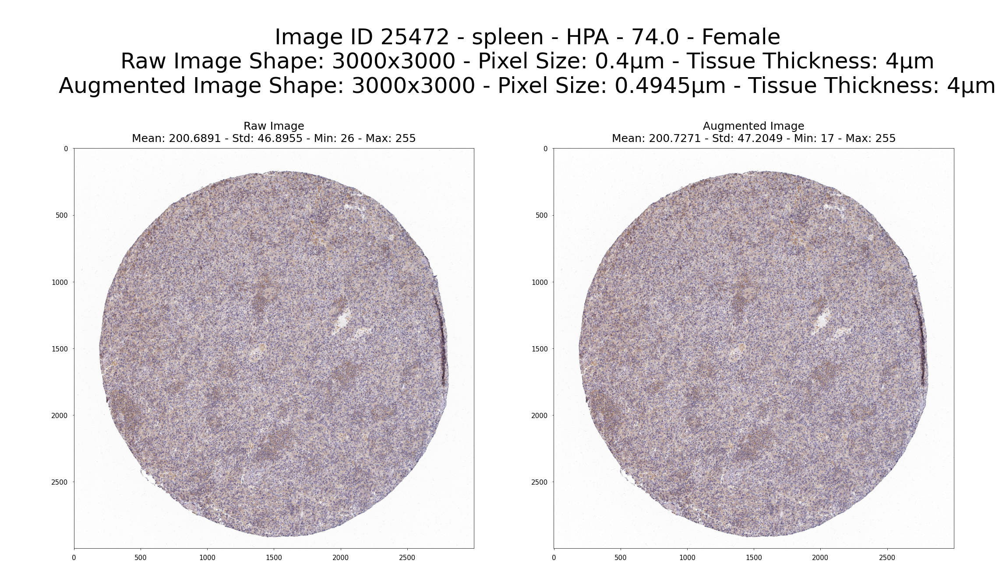

In [ ]:
for idx, row in df_sample.iterrows():
    
    image = tifffile.imread(row['image_filename'])
    image, image_augmented = augment_image(
        image=image,
        domain_pixel_size=imaging_measurements['hpa']['pixel_size'][row['organ']],
        target_pixel_size=imaging_measurements['hubmap']['pixel_size'][row['organ']],
        domain_tissue_thickness=imaging_measurements['hpa']['tissue_thickness'][row['organ']],
        target_tissue_thickness=imaging_measurements['hubmap']['tissue_thickness'][row['organ']],
        alpha=0.15
    )
    
    visualize_augmentation(
        image=image,
        image_augmented=image_augmented,
        metadata=row.to_dict()
    )
